In [ ]:
import tensorflow as tf

# Intenta detectar si estás ejecutando en una TPU
try:
    TPU = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Running on TPU ', TPU.master())
except ValueError:
    print('Running on GPU')
    TPU = None

# Si se detecta una TPU, configura la estrategia de distribución para aprovecharla
if TPU:
    tf.config.experimental_connect_to_cluster(TPU)
    tf.tpu.experimental.initialize_tpu_system(TPU)
    strategy = tf.distribute.experimental.TPUStrategy(TPU)
else:
    strategy = tf.distribute.get_strategy()  # Estrategia predeterminada para GPU o CPU

# Obtiene el número de réplicas en sincronización dentro de la estrategia
REPLICAS = strategy.num_replicas_in_sync
print(f'REPLICAS: {REPLICAS}')

# Tamaño base del lote que puede ser ajustado según tus necesidades
BATCH_SIZE_BASE = 16

# Calcula el tamaño de lote final multiplicando el tamaño base del lote por el número de réplicas
BATCH_SIZE = BATCH_SIZE_BASE * REPLICAS

# Imprime el tamaño de lote resultante
print(f'BATCH_SIZE: {BATCH_SIZE}')

In [ ]:
!pip install tensorflow

In [ ]:
!pip install efficientnet

In [ ]:
!pip install seaborn

In [ ]:
!pip install albumentations

In [6]:
# Librerias utilizadas (se puden haber añadido mas durante el desarrollo del codigo)
import glob
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import pandas as pd
import tensorflow as tf
from PIL import Image
import seaborn as sns
import sklearn.metrics as metrics
import sklearn.metrics as confusion_matrix
from sklearn.model_selection import train_test_split
import random

Preprocesamiento de los datos:
- Distribución de etiquetas
- Visualizar imágenes
- Identificar tamaño de las imágenes
- Análisis de valores atípicos
- Componer el conjunto de datos, es decir añadir a cada imágen su tipo correspodiente.

In [2]:
from PIL import Image
import os

# Ruta de la carpeta que contiene las imágenes
images_folder = '/kaggle/input/sorghum-id-fgvc-9/train_images/'

# Obtener estadísticas sobre el tamaño de las imágenes
image_sizes = []
for image_file in os.listdir(images_folder):
    image_path = os.path.join(images_folder, image_file)
    image = Image.open(image_path)
    width, height = image.size
    image_sizes.append((width, height))

# Estadísticas de tamaño
print("Estadísticas de tamaño de las imágenes:")
print("Resolución más común:", max(set(image_sizes), key=image_sizes.count))
print("Tamaño máximo:", max(image_sizes))
print("Tamaño mínimo:", min(image_sizes))

Estadísticas de tamaño de las imágenes:
Resolución más común: (1024, 1024)
Tamaño máximo: (1024, 1024)
Tamaño mínimo: (1024, 1024)


Lo primero que hemos comprobado ha sido el tamaño de las imágenes ya que puede afectar de manera significativa el tiempo y la memoria requerida durante el proceso de entrenamiento. Imágenes más grandes tienen más píxeles y, por lo tanto, requieren más tiempo para procesar y más memoria para almacenar. Redimensionar las imágenes a tamaños más pequeños puede ayudar a reducir el costo computacional y acelerar el entrenamiento del modelo.

Como vemos el tamaño es 1024x1024, este tamaño es relativamente grande. Así que una de las técnicas de pre-procesamiento que debemos aplicar será redimensionar las imágenes a un tamaño más adecuado.

El siguiente paso que vamos a llevar a cabo es asociar cada imágen con su etiqueta correspondiente. Podemos ver que la carpeta train_images contiene todos los archivos '.jpg' y dos archivos '.csv'. El archivo '.csv' que utilizaremos para añadir las etquetas será:

"train_cultivar_mapping.csv":

Este archivo contiene un mapeo de las imágenes de entrenamiento (train) a las variedades de cultivo. Proporciona una relación entre los nombres de las imágenes y las clases a las que pertenecen.

In [7]:
#Leemos el dataset como Dataframe
import pandas as pd

# Cargar el archivo CSV con el mapeo de imágenes y etiquetas
csv_path = '/kaggle/input/sorghum-id-fgvc-9/train_cultivar_mapping.csv'
df_mapping = pd.read_csv(csv_path)
df_mapping.head()

,image,cultivar
0,2017-06-16__12-24-20-930.png,PI_257599
1,2017-06-02__16-48-57-866.png,PI_154987
2,2017-06-12__13-18-07-707.png,PI_92270
3,2017-06-22__13-18-06-841.png,PI_152651
4,2017-06-26__12-56-48-642.png,PI_176766


A continuación vamos a mostrar en un gráfico la distribución de las etiquetas para visualizar si hay tenemos un dataset equilibrado o por el contrario está desequlibrado. Esto nos ayudará a comprender si hay clases con una cantidad muy pequeña de muestras que podrían afectar el rendimiento del modelo.

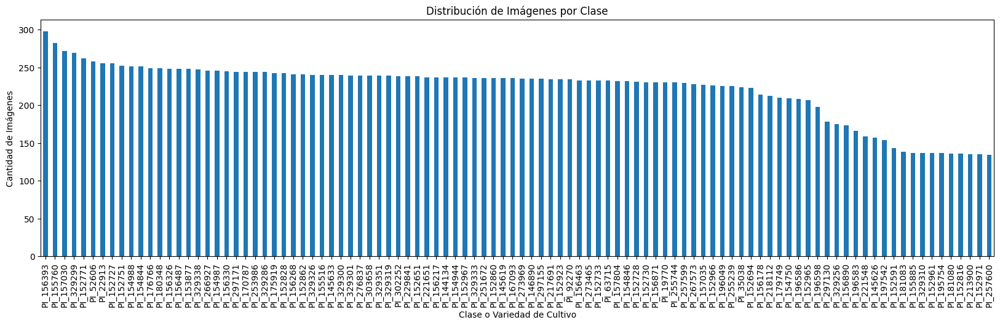

In [5]:
# Visualización de la distribución de etiquetas
plt.figure(figsize=(20, 5))
df_mapping['cultivar'].value_counts().plot(kind='bar')
plt.xticks(rotation='vertical')
plt.xlabel('Clase o Variedad de Cultivo')
plt.ylabel('Cantidad de Imágenes')
plt.title('Distribución de Imágenes por Clase')
plt.show()

Podemos observar el dataset puede estar desequilibrado. Algunas clases tienen más muestras que otras, en concreto se puede ver que son: 'PI_156178', 'PI_218112', 'PI_179749', 'PI_154750', 'PI_196586','PI_152965', 'PI_196598', 'PI_297130', 'PI_329256', 'PI_156890','PI_196583', 'PI_221548', 'PI_145626', 'PI_197542', 'PI_152591','PI_181083', 'PI_155885', 'PI_329310', 'PI_152961', 'PI_195754','PI_181080', 'PI_152816', 'PI_213900', 'PI_152971', 'PI_257600'.

Para abordar el desequilibrio de clases, aquí hay algunas opciones que podríamos considerar:
- Data augmentation
- Undersampling o Oversampling
- Peso de clase: Asignar pesos diferentes a las clases durante el entrenamiento, dándole más importancia a las clases minoritarias.

In [8]:
import pandas as pd

# Cargar el archivo CSV con el mapeo de imágenes y etiquetas
csv_path = '/kaggle/input/sorghum-id-fgvc-9/train_cultivar_mapping.csv'
df_mapping = pd.read_csv(csv_path)

# Obtener el conteo de muestras por cada clase
label_counts = df_mapping['cultivar'].value_counts()

# Calcular el porcentaje de cada clase respecto al total de muestras
total_samples = len(df_mapping)
label_percentages = label_counts / total_samples * 100

# Imprimir el conteo y porcentaje de cada clase
for label, count, percentage in zip(label_counts.index, label_counts.values, label_percentages.values):
    print(f'Clase: {label}, Cantidad: {count}, Porcentaje: {percentage:.2f}%')

# Identificar clases desequilibradas (ejemplo, porcentaje < 1%)
classes_desequilibradas = label_percentages[label_percentages < 1].index
print(f'Clases desequilibradas: {classes_desequilibradas}')

Clase: PI_156393, Cantidad: 298, Porcentaje: 1.34%
Clase: PI_155760, Cantidad: 282, Porcentaje: 1.27%
Clase: PI_157030, Cantidad: 272, Porcentaje: 1.23%
Clase: PI_329299, Cantidad: 269, Porcentaje: 1.21%
Clase: PI_152771, Cantidad: 262, Porcentaje: 1.18%
Clase: PI_52606, Cantidad: 258, Porcentaje: 1.16%
Clase: PI_22913, Cantidad: 255, Porcentaje: 1.15%
Clase: PI_152727, Cantidad: 255, Porcentaje: 1.15%
Clase: PI_152751, Cantidad: 252, Porcentaje: 1.14%
Clase: PI_154988, Cantidad: 251, Porcentaje: 1.13%
Clase: PI_154844, Cantidad: 251, Porcentaje: 1.13%
Clase: PI_176766, Cantidad: 249, Porcentaje: 1.12%
Clase: PI_180348, Cantidad: 249, Porcentaje: 1.12%
Clase: PI_156326, Cantidad: 248, Porcentaje: 1.12%
Clase: PI_156487, Cantidad: 248, Porcentaje: 1.12%
Clase: PI_153877, Cantidad: 248, Porcentaje: 1.12%
Clase: PI_329338, Cantidad: 247, Porcentaje: 1.11%
Clase: PI_266927, Cantidad: 246, Porcentaje: 1.11%
Clase: PI_154987, Cantidad: 246, Porcentaje: 1.11%
Clase: PI_156330, Cantidad: 245, 

El siguiente paso vamos a visualizar una imágen de cada calse como ejemplo

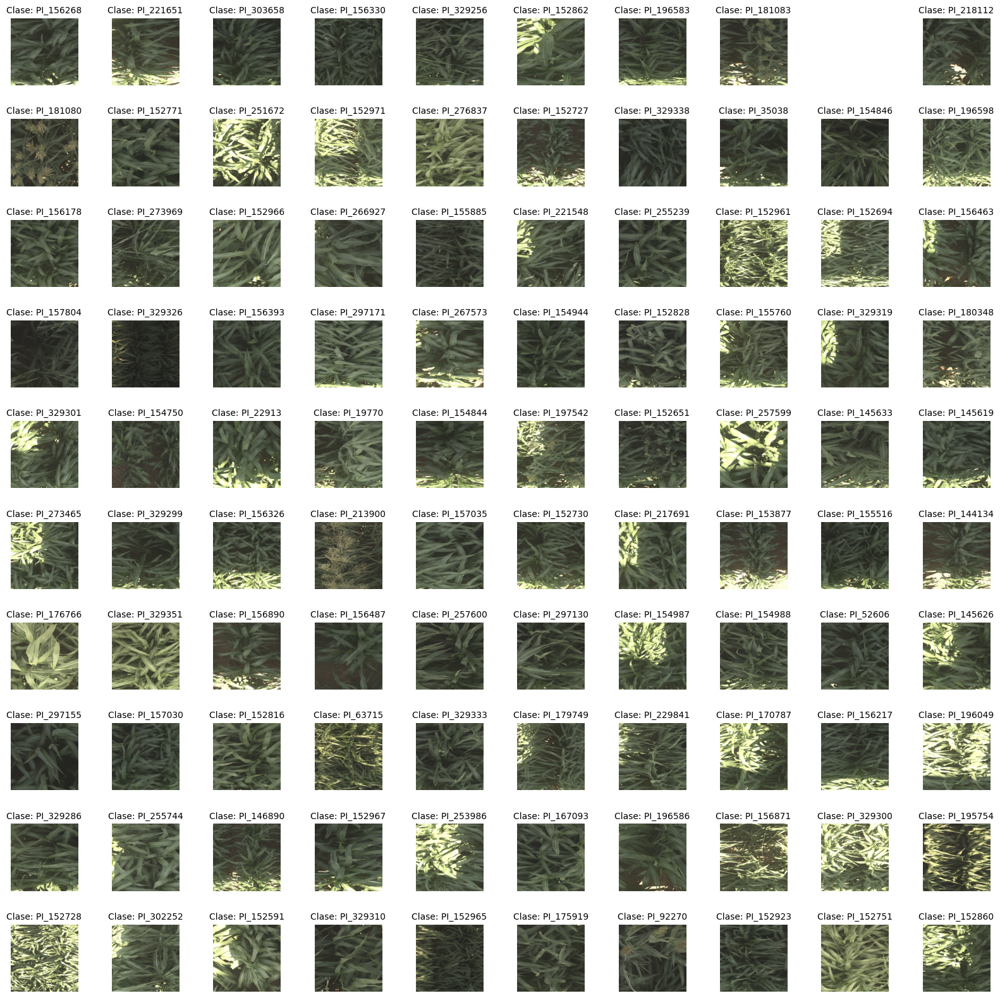

In [14]:
import glob
import random
import matplotlib.pyplot as plt
from PIL import Image
import pandas as pd

#Este codigo muestra una imagen de cada clase con el identificador de clase correspondiente

# Obtener la lista de rutas de imágenes
files = [f for f in glob.glob("/kaggle/input/sorghum-id-fgvc-9/train_images/*.png")]

# Verificar que haya al menos una imagen
if len(files) == 0:
    raise ValueError("No hay imágenes en el dataset.")

# Cargar el archivo de mapeo de etiquetas
df_mapping = pd.read_csv('/kaggle/input/sorghum-id-fgvc-9/train_cultivar_mapping.csv')

# Obtener las clases únicas que tienen al menos una imagen en el dataset
classes_with_images = df_mapping['cultivar'].unique()

# Elegir aleatoriamente 100 clases (una de cada clase)
sample_classes = random.sample(list(classes_with_images), 100)

# Crear una figura para mostrar las imágenes
fig = plt.figure(figsize=(20, 20))

# Tamaño deseado de las imágenes redimensionadas
target_size = (256, 256)

# Mostrar una imagen de cada clase después de redimensionarla en memoria
for i, cls in enumerate(sample_classes):
    fig.add_subplot(10, 10, i+1)
    plt.axis('off')
    
    # Obtener una imagen aleatoria de la clase actual
    class_images = df_mapping[df_mapping['cultivar'] == cls]['image'].tolist()
    if len(class_images) == 0:
        continue
    random_image = random.choice(class_images)
    img = Image.open('/kaggle/input/sorghum-id-fgvc-9/train_images/' + random_image)
    img_resized = img.resize(target_size, Image.LANCZOS)
    
    plt.imshow(img_resized)
    plt.title(f'Clase: {cls}', fontsize=10)

plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.show()

Vamos a comprobar si hay imágenes que no sirven, es decir, imágenes borrosas, imágenes de mala calidad, con poco contraste...
Son imágenes que se deberían descartar, ya que podrían entorpecer el entrenamiento del modelo.

En Kaggle he encontrado una libreta que expone algunas imágenes que se deberían descartar, la libreta es URL: https://www.kaggle.com/code/joonasyoon/fine-grained-cultivar-classification#Outliers-on-train-set

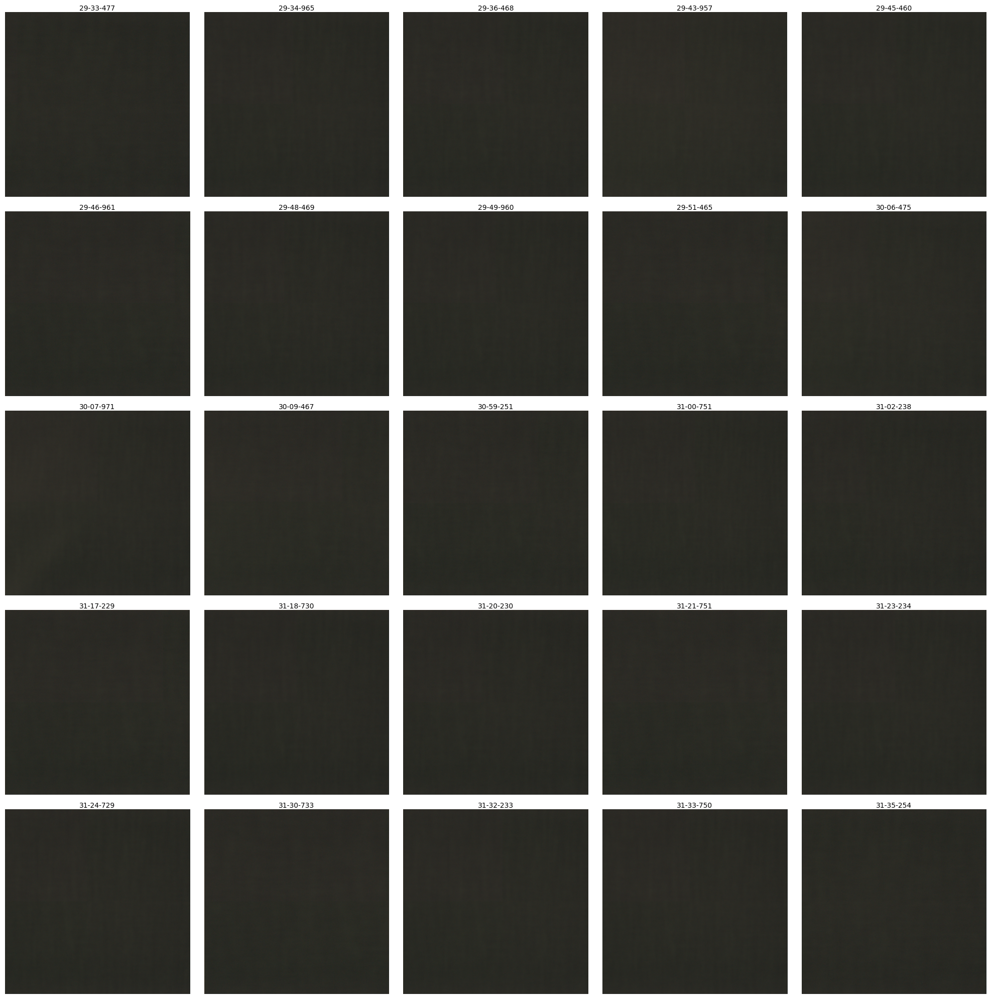

In [4]:
from PIL import Image
import matplotlib.pyplot as plt
import glob

# Obtener la lista de rutas de imágenes outliers
outliers = ['29-33-477', '29-34-965', '29-36-468', '29-43-957', '29-45-460', '29-46-961', '29-48-469', '29-49-960', '29-51-465', '30-06-475', '30-07-971', '30-09-467', '30-59-251', '31-00-751', '31-02-238', '31-17-229', '31-18-730', '31-20-230', '31-21-751', '31-23-234', '31-24-729', '31-30-733', '31-32-233', '31-33-750', '31-35-254']

# Crear una figura para mostrar las imágenes
fig = plt.figure(figsize=(20, 20))

# Calcular el tamaño de la cuadrícula para mostrar todas las imágenes outliers
grid_size = int(np.ceil(np.sqrt(len(outliers))))

# Mostrar las imágenes outliers seleccionadas en su tamaño original
for i, outlier in enumerate(outliers):
    fig.add_subplot(grid_size, grid_size, i+1)
    plt.axis('off')
    img_path = f"/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-{outlier}.png"
    img = Image.open(img_path)
    plt.imshow(img)
    plt.title(outlier, fontsize=10, pad=2)

plt.tight_layout()
plt.show()

Aún así, vamos a comprobar si hay alguna imágen más con fallos, vamos a crear un función que utilice un filtro para comparar todas las imágenes y nos muestre las de menor intensidad.

Imágenes borrosas:
['/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-15__13-09-26-144.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-26__11-39-54-016.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-16__12-24-48-376.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-12__13-16-48-515.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-01__11-29-00-903.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-02__18-05-24-928.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-17__13-08-25-831.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-21__11-35-18-962.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-17__12-59-25-806.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-19__18-12-23-671.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-26-13-869.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-13__11-17-44-572.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-26

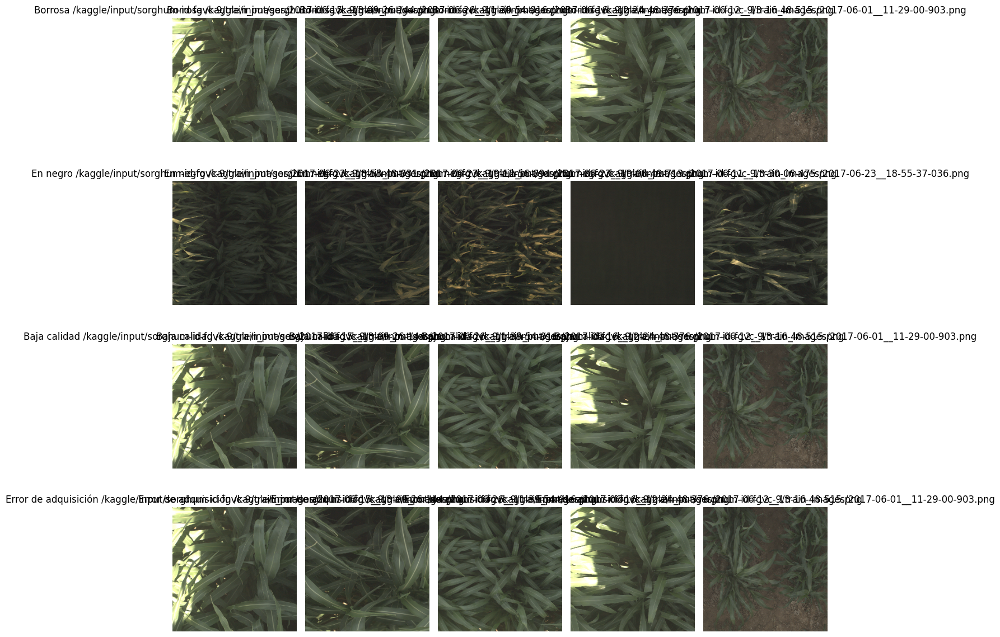

In [3]:
import cv2
import glob
import matplotlib.pyplot as plt

# Función para detectar imágenes borrosas
def detect_blurry_images(image_folder, focus_threshold):
    blurry_images = []
    for img_path in glob.glob(f"{image_folder}/*.png"):
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        focus_measure = cv2.Laplacian(img, cv2.CV_64F).var()
        if focus_measure < focus_threshold:
            blurry_images.append(img_path)
    return blurry_images

# Función para detectar imágenes en negro o de baja intensidad
def detect_dark_images(image_folder, intensity_threshold):
    dark_images = []
    for img_path in glob.glob(f"{image_folder}/*.png"):
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        mean_intensity = img.mean()
        if mean_intensity < intensity_threshold:
            dark_images.append(img_path)
    return dark_images

# Función para detectar imágenes de baja calidad
def detect_low_quality_images(image_folder, noise_threshold, contrast_threshold):
    low_quality_images = []
    for img_path in glob.glob(f"{image_folder}/*.png"):
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        noise_measure = cv2.Laplacian(img, cv2.CV_64F).var()
        contrast_measure = cv2.Laplacian(img, cv2.CV_64F).var()
        if noise_measure > noise_threshold or contrast_measure < contrast_threshold:
            low_quality_images.append(img_path)
    return low_quality_images

# Función para detectar imágenes con errores de adquisición
def detect_acquisition_errors(image_folder, contrast_threshold):
    error_images = []
    for img_path in glob.glob(f"{image_folder}/*.png"):
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        contrast = cv2.Laplacian(img, cv2.CV_64F).var()
        if contrast < contrast_threshold:
            error_images.append(img_path)
    return error_images

# Ruta de la carpeta que contiene las imágenes
image_folder = "/kaggle/input/sorghum-id-fgvc-9/train_images"

# Definir umbrales para cada técnica de detección
focus_threshold = 100
intensity_threshold = 50
noise_threshold = 1000
contrast_threshold = 100

# Obtener las listas de imágenes para cada técnica de detección
blurry_images = detect_blurry_images(image_folder, focus_threshold)
dark_images = detect_dark_images(image_folder, intensity_threshold)
low_quality_images = detect_low_quality_images(image_folder, noise_threshold, contrast_threshold)
error_images = detect_acquisition_errors(image_folder, contrast_threshold)

# Imprimir las listas de imágenes detectadas
print("Imágenes borrosas:")
print(blurry_images)

print("\nImágenes en negro o de baja intensidad:")
print(dark_images)

print("\nImágenes de baja calidad:")
print(low_quality_images)

print("\nImágenes con errores de adquisición:")
print(error_images)

# Redimensionar las imágenes a 256x256 antes de mostrarlas
def resize_images(image_paths):
    target_size = (256, 256)
    resized_images = []
    for img_path in image_paths:
        img = cv2.imread(img_path)
        img_resized = cv2.resize(img, target_size)
        resized_images.append(img_resized)
    return resized_images

# Redimensionar las imágenes antes de mostrarlas
blurry_images_resized = resize_images(blurry_images)
dark_images_resized = resize_images(dark_images)
low_quality_images_resized = resize_images(low_quality_images)
error_images_resized = resize_images(error_images)

# Mostrar las imágenes detectadas con cada técnica utilizando plt.imshow()
fig, axes = plt.subplots(4, 5, figsize=(12, 12))

# Mostrar imágenes borrosas
for i, ax in enumerate(axes[0]):
    if i < len(blurry_images_resized):
        ax.imshow(cv2.cvtColor(blurry_images_resized[i], cv2.COLOR_BGR2RGB))
        ax.axis('off')
        ax.set_title(f'Borrosa {blurry_images[i]}')

# Mostrar imágenes en negro o de baja intensidad
for i, ax in enumerate(axes[1]):
    if i < len(dark_images_resized):
        ax.imshow(cv2.cvtColor(dark_images_resized[i], cv2.COLOR_BGR2RGB))
        ax.axis('off')
        ax.set_title(f'En negro {dark_images[i]}')

# Mostrar imágenes de baja calidad
for i, ax in enumerate(axes[2]):
    if i < len(low_quality_images_resized):
        ax.imshow(cv2.cvtColor(low_quality_images_resized[i], cv2.COLOR_BGR2RGB))
        ax.axis('off')
        ax.set_title(f'Baja calidad {low_quality_images[i]}')
# Mostrar imágenes con errores de adquisición
for i, ax in enumerate(axes[3]):
    if i < len(error_images_resized):
        ax.imshow(cv2.cvtColor(error_images_resized[i], cv2.COLOR_BGR2RGB))
        ax.axis('off')
        ax.set_title(f'Error de adquisición {error_images[i]}')

plt.tight_layout()
plt.show()

Vamos a mostrar todas las imágenes, ya que en la celda anterior solo muestra algunas

In [5]:
import matplotlib.pyplot as plt
import cv2

def show_images_with_identifiers(image_paths):
    num_images = len(image_paths)
    ncols = 5
    nrows = (num_images - 1) // ncols + 1

    fig, axes = plt.subplots(nrows, ncols, figsize=(12, 3*nrows))

    for i, img_path in enumerate(image_paths):
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        row = i // ncols
        col = i % ncols

        ax = axes[row, col]
        ax.imshow(img_rgb)
        ax.axis('off')

        # Obtener el identificador de la imagen (nombre del archivo sin la ruta)
        identifier = img_path.split("/")[-1]

        ax.set_title(identifier, fontsize=8)

    # Ocultar ejes vacíos
    for i in range(num_images, nrows * ncols):
        axes.flatten()[i].axis('off')

    plt.tight_layout()
    plt.show()
    

image_paths =['/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-53-48-031.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-12-56-094.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-08-49-713.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-30-06-475.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-55-37-036.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-51-55-501.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-07-31-390.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-44-16-666.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-03-12-589.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-31-23-234.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-11-22-199.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-58-56-387.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-29-45-460.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-12-44-609.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-05-36-117.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-03-44-802.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-12-21-612.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-13-19-105.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-10-31-581.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-57-51-229.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-55-39-328.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-01-30-597.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-29-34-965.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-02-47-307.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-31-24-729.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-30-59-251.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-01-28-313.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-59-17-091.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-06-54-582.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-29-43-957.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-01-07-589.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-31-35-254.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-59-33-191.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-29-49-960.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-12-58-412.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-10-47-622.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-53-45-732.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-06-56-880.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-11-19-881.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-08-51-982.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-11-17-597.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-10-29-288.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-30-07-971.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-31-20-230.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-03-14-891.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-10-33-871.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-12-42-300.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-07-10-686.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-31-18-730.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-05-03-924.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-59-14-794.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-12-17-895.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-12-39-977.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-01-05-295.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-31-02-238.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-29-33-477.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-30-09-467.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-45-52-943.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-09-26-516.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-31-00-751.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-59-35-497.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-07-33-683.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-31-32-233.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-10-45-379.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-31-17-229.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-29-46-961.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-29-48-469.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-09-15-006.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-07-24-482.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-07-08-383.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-29-36-468.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-31-21-751.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-31-30-733.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-31-33-750.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-11__13-29-51-465.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-11-26-794.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__18-58-58-704.png', '/kaggle/input/sorghum-id-fgvc-9/train_images/2017-06-23__19-07-22-204.png']

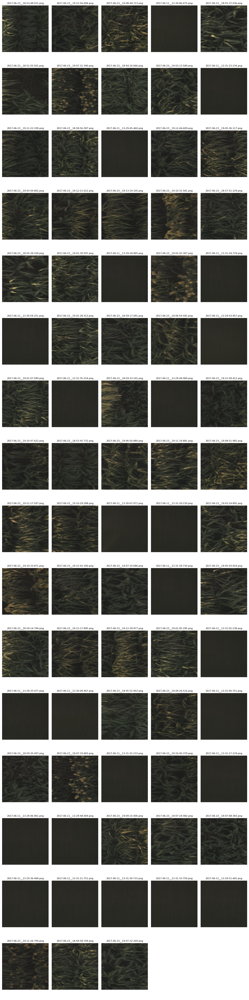

In [6]:
show_images_with_identifiers(image_paths)

Las imágenes oscuras que no se ven nada, se deben eliminar, ya que perjudicarán al modelo y no ayudarían a entrenar. Por otro lado, las que tienen poco brillo pueden ser interesantes. Ya que tener imágenes con distintos brillos puede ser interesante.

Otro tipo de error que podemos buscar en las imágenes y que no habia caido son imágenes muy iluminadas o blancas que no aportan nada de información, vamos a comprobar si hay alguna.

Seguimos con el análisis de los datos, vamos a comprobar si hay algún valor nulo.

In [8]:
df_mapping.isna().value_counts()

image  cultivar
False  False       22193
       True            1
dtype: int64

Observamos que tenemos uno, así que lo eliminamos

A continuación procedemos a aplicar el preprocesamiento sobre el dataset:

- Eliminar el archivo nulo
- Las imágenes que no sirven
- Redimensionar las imágenes a un tamaño más adecuado, posiblemente 512x512 o 256x256
- Aumentar el tamaño del dataset, haciendo uso de aumento de datos


Para eliminar las imágenes hemos hecho una lista con sus path para poder eliminarlos.

Path:
- 2017-06-11__13-30-06-475.png
- 2017-06-11__13-31-23-234.png
- 2017-06-11__13-29-45-460.png
- 2017-06-11__13-29-34-965.png
- 2017-06-11__13-31-24-729.png
- 2017-06-11__13-30-59-251.png
- 2017-06-11__13-29-43-957.png
- 2017-06-11__13-31-35-254.png
- 2017-06-11__13-29-49-960.png
- 2017-06-11__13-30-07-971.png
- 2017-06-11__13-31-20-230.png
- 2017-06-11__13-31-18-730.png
- 2017-06-11__13-31-02-238.png
- 2017-06-11__13-29-33-477.png
- 2017-06-11__13-30-09-467.png
- 2017-06-11__13-31-00-751.png
- 2017-06-11__13-31-32-233.png
- 2017-06-11__13-31-17-229.png
- 2017-06-11__13-29-46-961.png
- 2017-06-11__13-29-48-469.png
- 2017-06-11__13-29-36-468.png
- 2017-06-11__13-31-21-751.png
- 2017-06-11__13-31-30-733.png
- 2017-06-11__13-31-33-750.png
- 2017-06-11__13-29-51-465.png

Eliminamos el valor nulo y los outliers del dataset

In [9]:
df_mapping.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22194 entries, 0 to 22193
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   image     22194 non-null  object
 1   cultivar  22193 non-null  object
dtypes: object(2)
memory usage: 346.9+ KB


In [10]:
# Lista de imágenes a eliminar
outlier = ['2017-06-11__13-30-06-475.png',
    '2017-06-11__13-31-23-234.png',
    '2017-06-11__13-29-45-460.png',
    '2017-06-11__13-29-34-965.png',
    '2017-06-11__13-31-24-729.png',
    '2017-06-11__13-30-59-251.png',
    '2017-06-11__13-29-43-957.png',
    '2017-06-11__13-31-35-254.png',
    '2017-06-11__13-29-49-960.png',
    '2017-06-11__13-30-07-971.png',
    '2017-06-11__13-31-20-230.png',
    '2017-06-11__13-31-18-730.png',
    '2017-06-11__13-31-02-238.png',
    '2017-06-11__13-29-33-477.png',
    '2017-06-11__13-30-09-467.png',
    '2017-06-11__13-31-00-751.png',
    '2017-06-11__13-31-32-233.png',
    '2017-06-11__13-31-17-229.png',
    '2017-06-11__13-29-46-961.png',
    '2017-06-11__13-29-48-469.png',
    '2017-06-11__13-29-36-468.png',
    '2017-06-11__13-31-21-751.png',
    '2017-06-11__13-31-30-733.png',
    '2017-06-11__13-31-33-750.png',
    '2017-06-11__13-29-51-465.png']

# Crear una copia del DataFrame original para trabajar con él
df = df_mapping.copy()

# Eliminar las filas que contienen las imágenes en la lista "outlier"
df = df.drop(df[df['image'].isin(outlier)].index)

# Eliminar filas con valores nulos y restablecer los índices
df = df.dropna().reset_index(drop=True)

# Verificar si aún hay algún valor nulo en el DataFrame
print(df.isnull().sum())

# Verificar el nuevo tamaño del DataFrame después de la limpieza
print("Nuevo tamaño del DataFrame:", len(df))

image       0
cultivar    0
dtype: int64
Nuevo tamaño del DataFrame: 22168


In [11]:
df.info()
df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22168 entries, 0 to 22167
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   image     22168 non-null  object
 1   cultivar  22168 non-null  object
dtypes: object(2)
memory usage: 346.5+ KB


,image,cultivar
0,2017-06-16__12-24-20-930.png,PI_257599
1,2017-06-02__16-48-57-866.png,PI_154987
2,2017-06-12__13-18-07-707.png,PI_92270
3,2017-06-22__13-18-06-841.png,PI_152651
4,2017-06-26__12-56-48-642.png,PI_176766


Antes de comenzar con el preprocesamiento de las imágenes, es esencial que las etiquetas estén en un formato adecuado para el entrenamiento del modelo. Dado que tenemos 100 etiquetas distintas en nuestro conjunto de datos, llevar a cabo una codificación numérica de estas etiquetas.

In [12]:
from sklearn.preprocessing import LabelEncoder

# Crear una instancia de LabelEncoder
label_encoder = LabelEncoder()

# Codificar las etiquetas y agregar los valores codificados al DataFrame
df['encoded_label'] = label_encoder.fit_transform(df['cultivar'])

#Verificación del resultado

df.head()

,image,cultivar,encoded_label
0,2017-06-16__12-24-20-930.png,PI_257599,73
1,2017-06-02__16-48-57-866.png,PI_154987,29
2,2017-06-12__13-18-07-707.png,PI_92270,99
3,2017-06-22__13-18-06-841.png,PI_152651,6
4,2017-06-26__12-56-48-642.png,PI_176766,50


Verificamos que hay un valor númerico para cada una de las 100 clases:

In [13]:
unique_encoded_labels = df['encoded_label'].nunique()
print("Número de valores únicos en 'encoded_label':", unique_encoded_labels)

Número de valores únicos en 'encoded_label': 100


## Generación de Rutas de Imágenes a partir de Nombres de Archivo en Kaggle

Vamos a generar rutas de archivos de imágenes. Esta tarea es crucial para que podamos cargar y procesar las imágenes correctamente en etapas posteriores, como el preprocesamiento y la creación de modelos.

In [14]:
# Ruta base donde se almacenan las imágenes en Kaggle
base_image_dir = "/kaggle/input/sorghum-id-fgvc-9/train_images/"

# Concatenar el path base con los nombres de archivo de la columna "image"
df['image_path'] = base_image_dir + df['image']

df.head()

,image,cultivar,encoded_label,image_path
0,2017-06-16__12-24-20-930.png,PI_257599,73,/kaggle/input/sorghum-id-fgvc-9/train_images/2...
1,2017-06-02__16-48-57-866.png,PI_154987,29,/kaggle/input/sorghum-id-fgvc-9/train_images/2...
2,2017-06-12__13-18-07-707.png,PI_92270,99,/kaggle/input/sorghum-id-fgvc-9/train_images/2...
3,2017-06-22__13-18-06-841.png,PI_152651,6,/kaggle/input/sorghum-id-fgvc-9/train_images/2...
4,2017-06-26__12-56-48-642.png,PI_176766,50,/kaggle/input/sorghum-id-fgvc-9/train_images/2...


Para poder usar aceleradores en Kaggle, en este caso la TPU necesitamos que los archivos tengan una ruta de Google Colud Storage. Para ello debemos obtenerla y añadirla como otro path.
Tenemos toda la información sobre el uso de TPU: https://www.kaggle.com/docs/tpu

In [15]:
from kaggle_datasets import KaggleDatasets
# You can learn GCS Patsh for every datasets. Sometimes you can get error due to large data (look at Version 1). 
GCS_DS_PATH = KaggleDatasets().get_gcs_path('sorghum-id-fgvc-9')

In [16]:
GCS_DS_PATH

'gs://kds-b661f397d783a61f6509058b678035443a9551378465ba8e6cd83be3'

In [17]:
df["image_path_gcs"] = df["image"].apply(lambda image: f"{GCS_DS_PATH}/train_images/{image}")

df.head()

,image,cultivar,encoded_label,image_path,image_path_gcs
0,2017-06-16__12-24-20-930.png,PI_257599,73,/kaggle/input/sorghum-id-fgvc-9/train_images/2...,gs://kds-b661f397d783a61f6509058b678035443a955...
1,2017-06-02__16-48-57-866.png,PI_154987,29,/kaggle/input/sorghum-id-fgvc-9/train_images/2...,gs://kds-b661f397d783a61f6509058b678035443a955...
2,2017-06-12__13-18-07-707.png,PI_92270,99,/kaggle/input/sorghum-id-fgvc-9/train_images/2...,gs://kds-b661f397d783a61f6509058b678035443a955...
3,2017-06-22__13-18-06-841.png,PI_152651,6,/kaggle/input/sorghum-id-fgvc-9/train_images/2...,gs://kds-b661f397d783a61f6509058b678035443a955...
4,2017-06-26__12-56-48-642.png,PI_176766,50,/kaggle/input/sorghum-id-fgvc-9/train_images/2...,gs://kds-b661f397d783a61f6509058b678035443a955...


## División del Conjunto en Train, Validación y Prueba

En esta etapa, realizaremos una división en tres conjuntos distintos: entrenamiento, validación y prueba. El objetivo principal es permitir una evaluación realista y confiable del rendimiento del modelo en datos no vistos durante el proceso de entrenamiento.

#### División Inicial en Train, Validación y Prueba

En primer lugar, dividiremos el conjunto completo de imágenes en dos partes: una para el entrenamiento y la validación (denominada train_valid_df) y otra para la prueba (denominada test_df). La última parte, test_df, se mantendrá sin cambios y se utilizará únicamente al final del proceso para evaluar el rendimiento del modelo final.

#### División del Conjunto Train-Validación

Dentro de train_valid_df, aplicaremos una técnica de validación cruzada llamada Stratified K-Fold para dividirlo en dos subconjuntos: entrenamiento (train_df) y validación (valid_df). Esta técnica es particularmente útil cuando las clases no están equilibradas, ya que asegura que las proporciones de las clases se mantengan en ambos subconjuntos.

#### Conjunto de Prueba

El conjunto test_df que obtuvimos en la primera etapa se mantendrá separado y sin cambios hasta el final del proceso. Este conjunto se utilizará únicamente para medir el rendimiento final del modelo en datos completamente nuevos y no vistos. No se empleará en ningún aspecto del entrenamiento ni la validación.

En resumen, este proceso de división en tres etapas nos permite entrenar y afinar el modelo en el conjunto train_df, ajustar los hiperparámetros y validar en valid_df, y, finalmente, evaluar el rendimiento real en datos nuevos y no vistos utilizando test_df. Esta metodología es esencial para obtener una evaluación precisa y confiable de la capacidad de generalización del modelo en situaciones del mundo real.

In [18]:
train_valid_df, test_df = train_test_split(df, test_size=0.1, random_state=42, stratify=df['encoded_label'])
train_df, valid_df = train_test_split(train_valid_df, test_size=0.2, random_state=42, stratify=train_valid_df['encoded_label'])

Vamos a comprobar el numero de elementos que tiene cada conjunto

In [19]:
print("Train: ", train_df.shape)
print("Valid: ", valid_df.shape)
print("Test: ", test_df.shape)

Train:  (15960, 5)
Valid:  (3991, 5)
Test:  (2217, 5)


Los siguiente será definir las técnicas de preprocesamiento de las imágenes que utilizaremos en el modelo. Serán las siguentes:

## Técnica de Mejora del Contraste Limitado de la Ecualización del Histograma Adaptativo (CLAHE)

El Mejoramiento del Contraste Limitado de la Ecualización del Histograma Adaptativo (CLAHE) es una técnica de procesamiento de imágenes que se utiliza para mejorar el contraste y resaltar las características en imágenes con iluminación variable o irregular. A diferencia de la ecualización del histograma estándar, que puede exagerar el ruido en áreas con poca variación de intensidad, el CLAHE aplica la ecualización del histograma localmente en regiones pequeñas de la imagen. Esto limita el contraste amplificado en áreas con cambios abruptos y conserva detalles importantes.

En resumen, el CLAHE realiza las siguientes operaciones:

    -Divide la imagen en pequeñas regiones llamadas "tiles".
    -Calcula un histograma para cada tile.
    -Aplica la ecualización del histograma a cada tile, limitando los valores extremos para evitar la amplificación del ruido.
    -Combina los tiles ecualizados para obtener la imagen final con un contraste mejorado.


## Técnicas de Aumento de Datos

Aplicamos una serie de técnicas de aumento de datos utilizando capas de tf.keras.layers. Estas técnicas incluyen:

    -Rescaling: Normaliza los valores de píxeles en el rango [0,1].
    -Resizing: Cambia el tamaño de la imagen a 512x512 píxeles para que todas las imágenes tengan el mismo tamaño.
    -RandomFlip: Aplica volteos horizontales y verticales aleatorios.
    -RandomRotation: Realiza rotaciones aleatorias en un rango de ángulos.
    -RandomZoom: Realiza zooms aleatorios en altura y anchura.
    -RandomContrast: Ajusta el contraste de forma aleatoria.
    -RandomBrightness: Ajusta el brillo de forma aleatoria.

Además, se aplica la técnica de CutOut, que consiste en enmascarar aleatoriamente una parte de la imagen, simulando datos faltantes o dañados. Esto puede ayudar a que el modelo sea más robusto a información incompleta.

Estas técnicas de aumento de datos y preprocesamiento se aplican para mejorar la generalización del modelo y aumentar la variabilidad en los datos de entrenamiento, lo que puede conducir a un mejor rendimiento del modelo en nuevos datos.

In [ ]:
import numpy as np
import tensorflow as tf
import albumentations as A

## decoder 
def decode_fn(image,label, image_size=512):
    file_bytes = tf.io.read_file(image)
    img = tf.io.decode_png(file_bytes,channels=3)
    img = tf.image.resize(img,[image_size, image_size])
    img = tf.cast(img,tf.uint8) 
    return img, label

transform = A.Compose([
    A.CLAHE(clip_limit=40, tile_grid_size=(10, 10), p=1.0),
    A.Resize(512, 512),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=1),
    A.CoarseDropout(max_holes=16, max_height=16, max_width=16, min_holes=8, min_height=8, min_width=8, p=0.5),
])

def aug_fn(image, image_size=512):
    aug_img = transform(image = image)["image"]
    aug_img = tf.cast(aug_img/255, tf.float32)
    aug_img = tf.image.resize(aug_img,[image_size, image_size]) 
    return aug_img

def process_data(image,label, image_size=512):
    aug_img = tf.numpy_function(func=aug_fn, inp=[image], Tout=tf.float32)
    aug_img.set_shape((image_size,image_size), 3)
    return aug_img, label

def decode_image(filename, label, image_size=512):
    bits = tf.io.read_file(filename)
    image = tf.image.decode_jpeg(bits, channels=3)
    image = tf.image.resize(image, [image_size, image_size])
    image = tf.cast(image, tf.float32) / 255.0
    return image, label


Además hemos creado otra funcion:

- **view_image**: Proporciona una manera conveniente de visualizar imágenes y sus etiquetas. Esta                         función puede ser útil para verificar cómo se ven las imágenes después de las                           transformaciones y aumentos de datos antes de pasarlas al modelo.

In [22]:
def view_image(ds):
    image, label = next(iter(ds))
    image = image.numpy()
    label = label.numpy()
    
    fig = plt.figure(figsize=(22, 22))
    for i in range(20):
        ax = fig.add_subplot(4, 5, i+1, xticks=[], yticks=[])
        ax.imshow(image[i])
        ax.set_title(f"Label: {label[i]}")

**Cálculo del tamaño de batch**

El cálculo del tamaño de batch juega un papel crucial en la optimización del rendimiento y la utilización de recursos. Cómo kaggle nos proprociona aceleradores, en nuestro caso haremos uso de la TPU.

A medida que las TPUs pueden manejar una gran cantidad de cálculos en paralelo, es posible ajustar el tamaño de lote de manera que aproveche al máximo la capacidad de procesamiento de la TPU y reduzca el tiempo total de entrenamiento.

El código utilizado para calcular el tamaño de batch, lo hemos reutilizado de la siguiente libreta:
https://www.kaggle.com/code/erdican/effnet-tpu-without-tfrecords/notebook

In [ ]:
AUTO = tf.data.experimental.AUTOTUNE
BATCH_SIZE = 128

train_dataset = (
    tf.data.Dataset
    .from_tensor_slices((train_df.image_path, train_df.encoded_label))
    .map(decode_image, num_parallel_calls=AUTO)
    .map(data_augmentation, num_parallel_calls=AUTO)
    .repeat()
    .shuffle(1024)
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)

valid_dataset = (
    tf.data.Dataset
    .from_tensor_slices((valid_df.image_path, valid_df.encoded_label))
    .map(decode_image, num_parallel_calls=AUTO)
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)

test_dataset = (
    tf.data.Dataset
    .from_tensor_slices((val_df.image_path, val_df.encoded_label))
    .map(decode_image, num_parallel_calls=AUTO)
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)

Verificar los datasets credos y que se ha aplicado las técnicas correctamente:

In [ ]:
view_image(train_dataset)

In [ ]:
view_image(valid_dataset)

In [ ]:
view_image(test_dataset)

Comprobar el tamaño de las imágenes del dataset

In [ ]:
# Función para imprimir el tamaño de las imágenes en un dataset
def print_image_sizes(dataset, num_samples=5):
    sample_list = list(dataset.take(num_samples).as_numpy_iterator())
    
    for idx, (image, label) in enumerate(sample_list):
        print(f"Sample {idx + 1} - Image Shape: {image.shape}, Label: {label}")

# Imprimir tamaños de imágenes en train_dataset
print("Tamaños de imágenes en train_dataset:")
print_image_sizes(train_dataset)

# Imprimir tamaños de imágenes en valid_dataset
print("\nTamaños de imágenes en valid_dataset:")
print_image_sizes(valid_dataset)

# Imprimir tamaños de imágenes en test_dataset
print("\nTamaños de imágenes en test_dataset:")
print_image_sizes(test_dataset)

Vamos a utilizar la técnica de TransFerlerning, vamos a usar un modelo base, el cuál adaptaremos a nuestros datos. Los modelos elegidos son:

- Resnet50
- EfficientNetB3

## Modelo Resnet50


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Input, GlobalAveragePooling2D, GlobalMaxPooling2D, Concatenate, Dropout, Dense
from tensorflow.keras.models import Model
import tensorflow_addons as tfa

## Definir el input shape deseado
input_shape = (512, 512, 3)

## Crear el modelo personalizado
def get_model_resnet():
    tf.keras.backend.clear_session()
    
    tf.config.optimizer.set_jit(True)
    
    with strategy.scope():
    
        base_model = ResNet50(weights='imagenet', include_top=False)
        image = Input(shape=input_shape, name='image', dtype=tf.float32)
        backbone = base_model(image)
        avg_pool = GlobalAveragePooling2D()(backbone)
        max_pool = GlobalMaxPooling2D()(backbone)
        pretrained_out = Concatenate()([avg_pool, max_pool])

        outputs = Dropout(0.25)(pretrained_out)
        outputs = Dense(N_CULTIVAR, activation="softmax", name='predictions')(outputs)

        model = Model(inputs=image, outputs=outputs)

        optimizer = tfa.optimizers.AdamW(weight_decay=1e-8)
        
        loss = {
            'predictions': tf.keras.losses.SparseCategoricalCrossentropy(),
        }
        
        metricsx = [
            tf.keras.metrics.SparseTopKCategoricalAccuracy(k=1, name='top1acc'),
        ]

        model.compile(optimizer=optimizer, loss=loss, metrics=metricsx)

        return model

In [ ]:
model = get_model_resnet()

In [ ]:
model.summary()

## Modelo EfficientNetB3

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, GlobalAveragePooling2D, GlobalMaxPooling2D, Concatenate, Dropout, Dense
import efficientnet.tfkeras as efn
import tensorflow_addons as tfa

input_shape = (512, 512, 3)
N_CULTIVAR = 100

def get_model_efficientnet():
    tf.keras.backend.clear_session()
    
    tf.config.optimizer.set_jit(True)

    with strategy.scope():
        
        image = Input(shape=input_shape, name='image', dtype=tf.float32)
        backbone = efn.EfficientNetB3(weights = 'noisy-student', include_top = False)(image)
        avg_pool = tf.keras.layers.GlobalAveragePooling2D()(backbone)
        max_pool = tf.keras.layers.GlobalMaxPooling2D()(backbone)
        pretrained_out = tf.keras.layers.Concatenate()([avg_pool, max_pool])
        
        # You can choose one of the pooling layers.
        
        outputs = layers.Dropout(0.25)(pretrained_out)
        
        outputs = layers.Dense(N_CULTIVAR, activation="softmax", name='predictions')(outputs)
        
        model = Model(inputs=image, outputs=outputs)
        
        # OPTIMIZER

        optimizer = tfa.optimizers.AdamW(weight_decay=1e-8)
        
        # LOSS
        loss = {
            'predictions': losses.SparseCategoricalCrossentropy(),
        }
 
        # METRICS
        metricsx =[
            metrics.SparseTopKCategoricalAccuracy(k=1, name='top1acc'),
        ]

        # Compile Model
        model.compile(optimizer=optimizer, loss=loss, metrics=metricsx)

        return model


In [ ]:
model_2 = get_model_efficientnet()

In [ ]:
model_2.summary()

In [ ]:
N_EPOCHS = 31

## LearningRate

In [ ]:
import math
import matplotlib.pyplot as plt

class CosineScheduler():
    def __init__(self, max_update, base_lr=0.01, final_lr=0,
               warmup_steps=0, warmup_begin_lr=0):
        # Guardar los hiperparámetros para el ajuste de la tasa de aprendizaje
        self.base_lr_orig = base_lr
        self.max_update = max_update
        self.final_lr = final_lr
        self.warmup_steps = warmup_steps
        self.warmup_begin_lr = warmup_begin_lr
        self.max_steps = self.max_update - self.warmup_steps

    def get_warmup_lr(self, epoch):
        # Calcular la tasa de aprendizaje durante el calentamiento
        increase = (self.base_lr_orig - self.warmup_begin_lr) \
                       * float(epoch) / float(self.warmup_steps)
        return self.warmup_begin_lr + increase

    def __call__(self, epoch):
        # Ajustar la tasa de aprendizaje según la estrategia de descenso de aprendizaje coseno
        
        if epoch < self.warmup_steps:
            # Si todavía estamos en la fase de calentamiento, use la tasa de aprendizaje de calentamiento
            return self.get_warmup_lr(epoch)
        if epoch <= self.max_update:
            # Calcular la tasa de aprendizaje según la fórmula del descenso de aprendizaje coseno
            self.base_lr = self.final_lr + (
                self.base_lr_orig - self.final_lr) * (1 + math.cos(
                math.pi * (epoch - self.warmup_steps) / self.max_steps)) / 2
        return self.base_lr

# Crear una instancia del planificador con los hiperparámetros deseados
scheduler = CosineScheduler(max_update=N_EPOCHS, base_lr=1e-3, final_lr=1e-4, warmup_steps=3, warmup_begin_lr=1e-4)

# Crear una lista de tasas de aprendizaje calculadas por el planificador para cada época
lr_values = [scheduler(t) for t in range(N_EPOCHS)]

# Graficar las tasas de aprendizaje en función de las épocas
plt.plot(lr_values)
plt.xlabel('Epoch')
plt.ylabel('Learning Rate')
plt.title('Learning Rate Schedule')
plt.show()

## Callbacks

In [ ]:
model_checkpoint_callback_resnet = ModelCheckpoint(
    'model_best_resnet.h5',  # Nombre de archivo único para ResNet50
    monitor='loss', 
    verbose=1, 
    save_best_only=True, 
    save_weights_only=True
)

model_checkpoint_callback_effnet = ModelCheckpoint(
    'model_best_effnet.h5',  # Nombre de archivo único para EfficientNet
    monitor='loss', 
    verbose=1, 
    save_best_only=True, 
    save_weights_only=True
)

model_checkpoint_callback_resnet.set_model(model)
model_checkpoint_callback_effnet.set_model(model_2)

learning_rate_callback = callbacks.LearningRateScheduler(scheduler, verbose=1)


In [ ]:
STEPS_PER_EPOCH = len(train_df) // BATCH_SIZE

STEPS_PER_EPOCH

## Entrenamiento y métricas evaluación Resnet50

In [ ]:
history = model.fit(train_dataset,
                    validation_data=valid_dataset,
                    epochs=N_EPOCHS,
                    callbacks=[learning_rate_callback,
                              model_checkpoint_callback_resnet,],
                    steps_per_epoch=STEPS_PER_EPOCH
                   )
                   
print('Evaluacion del modelo: ' )                   
model.evaluate(test_dataset)

In [ ]:
import matplotlib.pyplot as plt

# Gráfica de pérdida
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('ResNet50 Model: Train & Validation Loss')
plt.show()

In [ ]:
# Gráfica de precisión
plt.figure(figsize=(10, 6))
plt.plot(history.history['top1acc'], label='Top-1 Accuracy')
plt.plot(history.history['val_top1acc'], label='Validation Top-1 Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Top-1 Accuracy')
plt.legend()
plt.title('ResNet50 Model: Top-1 Accuracy')
plt.show()

In [ ]:
from sklearn.metrics import confusion_matrix

# Matriz de confusion
# Obtener las predicciones del modelo Resnet50 en el conjunto de pruebas
y_test = test_df['encoded_label']
predictions_resnet = model.predict(test_dataset)
y_pred_resnet = np.argmax(predictions_resnet, axis=1)
y_true_resnet = y_test

class_names = label_encoder.classes_

confusion_matrix_resnet = confusion_matrix(y_true_resnet, y_pred_resnet)

df_cm_resnet = pd.DataFrame(confusion_matrix_resnet, index=class_names, columns=class_names)
plt.figure(figsize=(20, 20))
sns.heatmap(df_cm_resnet, annot=True)
plt.title('Confusion Matrix - ResNet50')
plt.show()

In [ ]:
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

# Métricas de precisión, recuperación y F1-score promedio ponderado
precision_resnet = precision_score(y_true_resnet, y_pred_resnet, average='weighted')
recall_resnet = recall_score(y_true_resnet, y_pred_resnet, average='weighted')
f1_resnet = f1_score(y_true_resnet, y_pred_resnet, average='weighted')

print("Metrics - ResNet50:")
print(f"Precision: {precision_resnet}")
print(f"Recall: {recall_resnet}")
print(f"F1-score: {f1_resnet}")

## Entrenamiento y métricas evaluación EfficientNetB3

In [ ]:
history_2 = model_2.fit(train_dataset,
                    validation_data=valid_dataset,
                    epochs=N_EPOCHS,
                    callbacks=[learning_rate_callback,
                              model_checkpoint_callback_effnet,],
                    steps_per_epoch=STEPS_PER_EPOCH
                   )
                   
print('Evaluacion del modelo: ' )

model_2.evaluate(test_dataset)

In [ ]:
import matplotlib.pyplot as plt

# Gráfica de pérdida
plt.figure(figsize=(10, 6))
plt.plot(history_2.history['loss'], label='Train Loss')
plt.plot(history_2.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('EfficientNet Model: Train & Validation Loss')
plt.show()

In [ ]:
# Gráfica de precisión
plt.figure(figsize=(10, 6))
plt.plot(history_2.history['top1acc'], label='Top-1 Accuracy')
plt.plot(history_2.history['val_top1acc'], label='Validation Top-1 Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Top-1 Accuracy')
plt.legend()
plt.title('EfficientNet Model: Top-1 Accuracy')
plt.show()

In [ ]:
# Matriz de confusión para el modelo EfficientNet
from sklearn.metrics import confusion_matrix

y_test = test_df['encoded_label']
predictions_effnet = model_2.predict(test_dataset)
y_pred_effnet = np.argmax(predictions_effnet, axis=1)
y_true_effnet = y_test

class_names = label_encoder.classes_
confusion_matrix_effnet = confusion_matrix(y_true=y_true_effnet, y_pred=y_pred_effnet)

df_cm_effnet = pd.DataFrame(confusion_matrix_effnet, index=class_names, columns=class_names)
plt.figure(figsize=(20, 20))
sns.heatmap(df_cm_effnet, annot=True)
plt.title('Confusion Matrix - EfficientNet')
plt.show()

In [ ]:
# Métricas de precisión, recuperación y F1-score promedio ponderado
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

precision_effnet = precision_score(y_true_effnet, y_pred_effnet, average='weighted')
recall_effnet = recall_score(y_true_effnet, y_pred_effnet, average='weighted')
f1_effnet = f1_score(y_true_effnet, y_pred_effnet, average='weighted')

print("\nMetrics - EfficientNet:")
print(f"Precision: {precision_effnet}")
print(f"Recall: {recall_effnet}")
print(f"F1-score: {f1_effnet}")